In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=True, fontsize=20, figsize=(12, 12))



endo = ['PECAM1']
mes1 = [ 'CHI3L1', 'ANXA2', 'ANXA1', 'CD44', 'VIM', 'MT2A', 'C1S', 'NAMPT', 'EFEMP1',
    'C1R', 'SOD2', 'IFITM3', 'TIMP1', 'SPP1', 'A2M', 'S100A11', 'MT1X', 'S100A10', 'FN1',
    'LGALS1', 'S100A16', 'CLIC1', 'MGST1', 'RCAN1', 'TAGLN2', 'NPC2', 'SERPING1', 'C8orf4', 'EMP1',
    'APOE', 'CTSB', 'C3', 'LGALS3', 'MT1E', 'EMP3', 'SERPINA3', 'ACTN1', 'PRDX6', 'IGFBP7',
    'SERPINE1', 'PLP2', 'MGP', 'CLIC4', 'GFPT2', 'GSN', 'NNMT', 'TUBA1C', 'GJA1', 'TNFRSF1A', 'WWTR1'
]
mes2 = [
    'HILPDA', 'ADM', 'DDIT3', 'NDRG1', 'HERPUD1', 'DNAJB9', 'TRIB3', 'ENO2', 'AKAP12',
    'SQSTM1', 'MT1X', 'ATF3', 'NAMPT', 'NRN1', 'SLC2A1', 'BNIP3', 'LGALS3', 'INSIG2', 'IGFBP3',
    'PPP1R15A', 'VIM', 'PLOD2', 'GBE1', 'SLC2A3', 'FTL', 'WARS', 'ERO1L', 'XPOT', 'HSPA5',
    'GDF15', 'ANXA2', 'EPAS1', 'LDHA', 'P4HA1', 'SERTAD1', 'PFKP', 'PGK1', 'EGLN3', 'SLC6A6',
    'CA9', 'BNIP3L', 'RPL21', 'TRAM1', 'UFM1', 'ASNS', 'GOLT1B', 'ANGPTL4', 'SLC39A14', 'CDKN1A', 'HSPA9'
]
mes = mes1 + mes2 + ["ENO2", "HILPDA", "ANXA1", "ANXA2"]

ac = ['CST3', 'S100B', 'SLC1A3', 'HEPN1', 'HOPX', 'MT3', 'SPARCL1', 'MLC1', 'GFAP',
    'FABP7', 'BCAN', 'PON2', 'METTL7B', 'SPARC', 'GATM', 'RAMP1', 'PMP2', 'AQP4', 'DBI',
    'EDNRB', 'PTPRZ1', 'CLU', 'PMP22', 'ATP1A2', 'S100A16', 'HEY1', 'PCDHGC3', 'TTYH1', 'NDRG2',
    'PRCP', 'ATP1B2', 'AGT', 'PLTP', 'GPM6B', 'F3', 'RAB31', 'PPAP2B', 'ANXA5', 'TSPAN7'
] +   ["CST3", "S100B", "MLC1"]

opc = ['BCAN', 'PLP1', 'GPR17', 'FIBIN', 'LHFPL3', 'OLIG1', 'PSAT1', 'SCRG1', 'OMG',
    'APOD', 'SIRT2', 'TNR', 'THY1', 'PHYHIPL', 'SOX2-OT', 'NKAIN4', 'LPPR1', 'PTPRZ1', 'VCAN',
    'DBI', 'PMP2', 'CNP', 'TNS3', 'LIMA1', 'CA10', 'PCDHGC3', 'CNTN1', 'SCD5', 'P2RX7',
    'CADM2', 'TTYH1', 'FGF12', 'TMEM206', 'NEU4', 'FXYD6', 'RNF13', 'RTKN', 'GPM6B', 'LMF1',
    'ALCAM', 'PGRMC1', 'HRASLS', 'BCAS1', 'RAB31', 'PLLP', 'FABP5', 'NLGN3', 'SERINC5', 'EPB41L2', 'GPR37L1'
] + ["OMG", "PLLP"]

npc1 = ['DLL3', 'DLL1', 'SOX4', 'TUBB3', 'HES6', 'TAGLN3', 'NEU4', 'MARCKSL1', 'CD24',
    'STMN1', 'TCF12', 'BEX1', 'OLIG1', 'MAP2', 'FXYD6', 'PTPRS', 'MLLT11', 'NPPA', 'BCAN',
    'MEST', 'ASCL1', 'BTG2', 'DCX', 'NXPH1', 'HN1', 'PFN2', 'SCG3', 'MYT1', 'CHD7',
    'GPR56', 'TUBA1A', 'PCBP4', 'ETV1', 'SHD', 'TNR', 'AMOTL2', 'DBN1', 'HIP1', 'ABAT',
    'ELAVL4', 'LMF1', 'GRIK2', 'SERINC5', 'TSPAN13', 'ELMO1', 'GLCCI1', 'SEZ6L', 'LRRN1', 'SEZ6', 'SOX11'
]

npc2 = ['STMN2', 'CD24', 'RND3', 'HMP19', 'TUBB3', 'MIAT', 'DCX', 'NSG1', 'ELAVL4',
    'MLLT11', 'DLX6-AS1', 'SOX11', 'NREP', 'FNBP1L', 'TAGLN3', 'STMN4', 'DLX5', 'SOX4', 'MAP1B',
    'RBFOX2', 'IGFBPL1', 'STMN1', 'HN1', 'TMEM161B-AS1', 'DPYSL3', 'SEPT3', 'PKIA', 'ATP1B1', 'DYNC1I1',
    'CD200', 'SNAP25', 'PAK3', 'NDRG4', 'KIF5A', 'UCHL1', 'ENO2', 'KIF5C', 'DDAH2', 'TUBB2A',
    'LBH', 'LOC150568', 'TCF4', 'GNG3', 'NFIB', 'DPYSL5', 'CRABP1', 'DBN1', 'NFIX', 'CEP170', 'BLCAP'
]
npc = npc1 + npc2 + ["SOX4", "RND3", "SOX11"]

g1_s = ['RRM2', 'PCNA', 'KIAA0101', 'HIST1H4C', 'MLF1IP', 'GMNN', 'RNASEH2A', 'MELK', 'CENPK', 'TK1',
    'TMEM106C', 'CDCA5', 'CKS1B', 'CDC45', 'MCM3', 'CENPM', 'AURKB', 'PKMYT1', 'MCM4', 'ASF1B',
    'GINS2', 'MCM2', 'FEN1', 'RRM1', 'DUT', 'RAD51AP1', 'MCM7', 'CCNE2', 'ZWINT'
]

g2_m = ['CCNB1', 'CDC20', 'CCNB2', 'PLK1', 'CCNA2', 'CKAP2', 'KNSTRN', 'RACGAP1', 'CDCA3', 'TROAP',
    'KIF2C', 'AURKA', 'CENPF', 'KPNA2', 'KIF20A', 'ECT2', 'BUB1', 'CDCA8', 'BUB1B', 'TACC3',
    'TTK', 'TUBA1C', 'NCAPD2', 'ARL6IP1', 'KIF4A', 'CKAP2L', 'MZT1', 'KIFC1', 'SPAG5', 'ANP32E',
    'KIF11', 'PSRC1', 'TUBB4B', 'SMC4', 'MXD3', 'CDC25B', 'OIP5', 'REEP4', 'FOXM1', 'TMPO',
    'GPSM2', 'HMGB3', 'ARHGAP11A', 'RANGAP1', 'H2AFZ'
]

stemness = ["SOX4", "CCND2", "SOX11", "RBM6", "HNRNPH1", "HNRNPL", "PTMA", "TRA2A", "SET", "C6orf62",
    "PTPRS", "CHD7", "CD24", "H3F3B", "C14orf23", "NFIB", "SRGAP2C", "STMN2", "SOX2", "TFDP2",
    "CORO1C", "EIF4B", "FBLIM1", "SPDYE7P", "TCF4", "ORC6", "SPDYE1", "NCRUPAR", "BAZ2B", "NELL2",
    "OPHN1", "SPHKAP", "RAB42", "LOH12CR2", "ASCL1", "BOC", "ZBTB8A", "ZNF793", "TOX3", "EGFR",
    "PGM5P2", "EEF1A1", "MALAT1", "TATDN3", "CCL5", "EVI2A", "LYZ", "POU5F1", "FBXO27", "CAMK2N1",
    "NEK5", "PABPC1", "AFMID", "QPCTL", "MBOAT1", "HAPLN1", "LOC90834", "LRTOMT", "GATM-AS1",
    "AZGP1", "RAMP2-AS1", "SPDYE5", "TNFAIP8L1"
]

male = ["SRY", "ZFY", "DDX3Y", "RPS4Y1"]
female = ["XIST"]

opc_npc = npc + opc
subset_genes = endo + mes + ac + opc + npc
all_genes =  g1_s + g2_m + stemness + npc + opc + mes + ac + endo 

/Users/shaunie/Desktop/hu-glioblastoma/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.10.4 anndata==0.11.1 umap==0.5.7 numpy==2.0.2 scipy==1.14.1 pandas==2.2.3 scikit-learn==1.5.2 statsmodels==0.14.4 igraph==0.11.8 louvain==0.8.2 pynndescent==0.5.13


In [2]:
adata = sc.read('write/human_combined_4.h5ad')
# sc.pp.log1p(adata)
# redo neighbors and umap
# sc.pp.neighbors(adata, n_pcs=13, n_neighbors=10)

In [3]:
adata.obs
# list the batch types
adata.obs['batch'].value_counts()

# lets isola

batch
1914d_human    8707
1919_human     7310
1919d_human    7102
1914_human     1481
Name: count, dtype: int64

In [4]:
# # sc.pl.umap(adata, color="batch", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)")
# # filter to 1914d_human
# # adata_filtered = adata[(adata.obs['batch'] == '1914d_human') | (adata.obs['batch'] == '1914_human')]
# adata_filtered = adata
# # sc.pl.umap(adata, color=female_like, size=70)
# # add up the expression of female_like genes and put it in adata.var
# # try and remove the genes that cause a key error
# try:
#     data = adata_filtered[:, female].X.toarray()
# except KeyError:
#     female = [g for g in female if g in adata_filtered.var_names]
#     data = adata_filtered[:, female].X.toarray()
    
# gene_number = len(female)
# female_expression = np.sum(data, axis=1)
# # normalize to the total expression
# female_expression = female_expression / gene_number
# adata_filtered.obs = adata_filtered.obs.assign(female_expression=pd.Series(female_expression, index=adata_filtered.obs.index))
# sc.pl.umap(adata_filtered, color='female_expression', vmin=0, vmax=1, size=120, alpha=0.8, title='female', cmap='RdBu_r' )
# sc.pl.umap(adata_filtered, color="batch", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)")


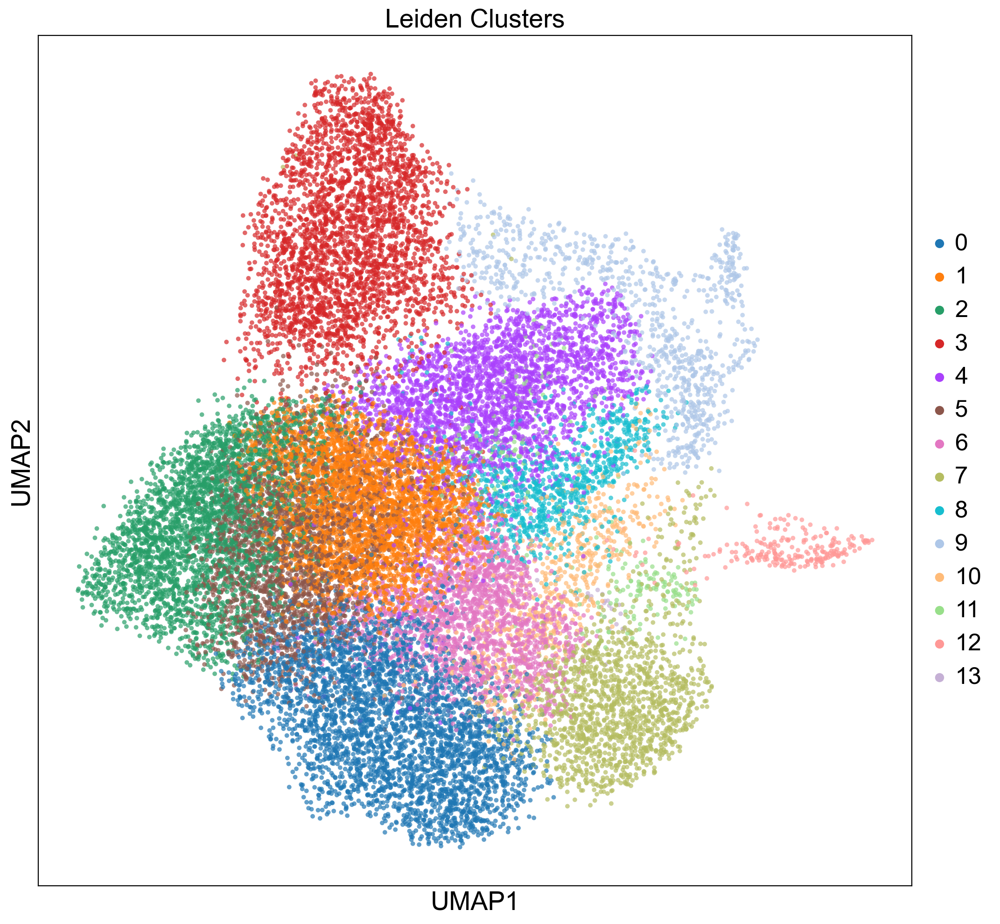

In [25]:
sc.pl.umap(adata, color="leiden", size=50, alpha=0.7, title="Leiden Clusters")


In [68]:
def rank_gene_groups(running_on, category='leiden', number_of_genes = 25, method = "t-test"):    
    for item in running_on:
        sc.tl.rank_genes_groups(item, category, method=method)
        sc.pl.rank_genes_groups(item, n_genes=number_of_genes, sharey=False, pts=True)
        ranked_genes = item.uns['rank_genes_groups']
        # print(ranked_genes)
        # print the structure of the ranked genes
        print(ranked_genes.keys())
        # convert dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges']) to a dataframe
        # filter names by pvals_adj < 0.05
        
        stored_items = pd.DataFrame(ranked_genes['names'])
        p_vals = pd.DataFrame(ranked_genes['pvals_adj'])
        scores = pd.DataFrame(ranked_genes['scores'])
        logfoldchanges = pd.DataFrame(ranked_genes['logfoldchanges'])
        
               
        stored_items.to_csv('write/ranked_genes.csv')
        p_vals.to_csv('write/pvals_adj.csv')
        scores.to_csv('write/scores.csv')
        logfoldchanges.to_csv('write/logfoldchanges.csv')
        
    
    
    # stored_items.to_csv('write/ranked_genes.csv')


# Aprrox. 10 sec per group
# rank_gene_groups([adata])

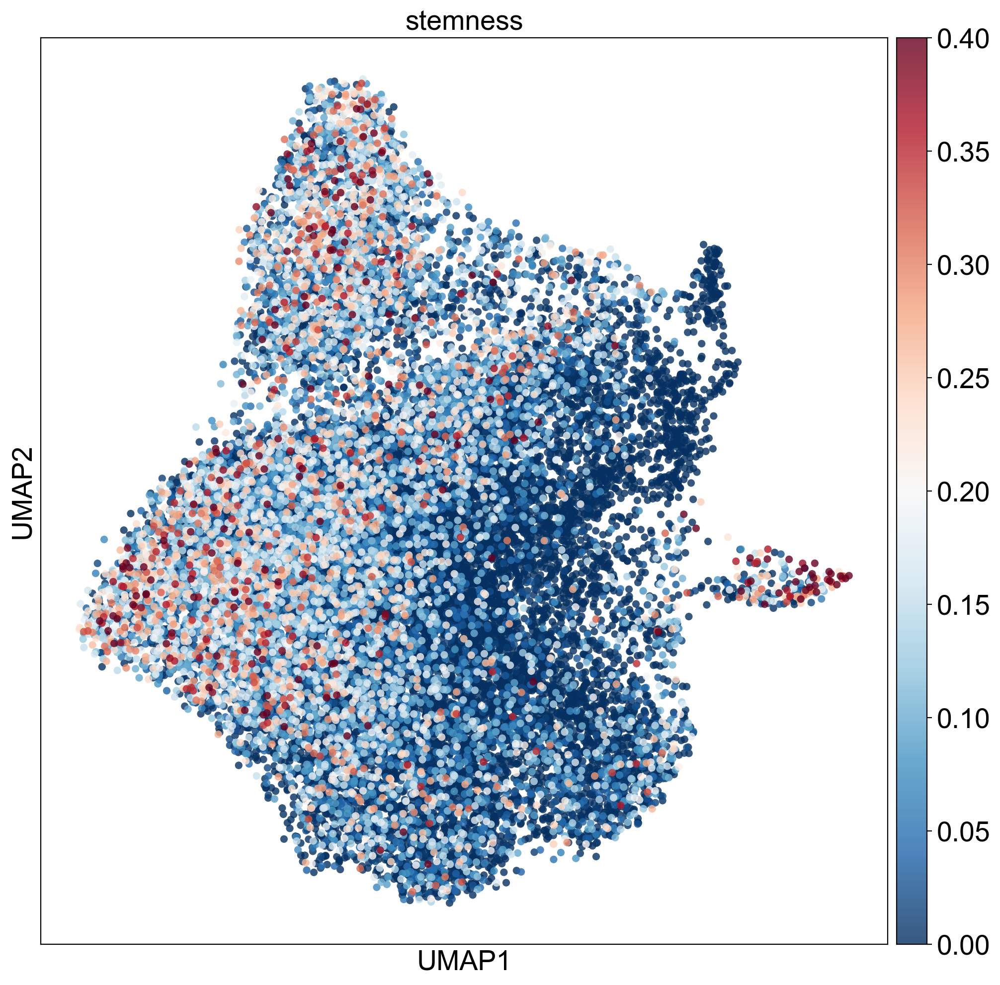

In [38]:
# sc.pl.umap(adata, color=stemness_like, size=70)
# add up the expression of stemness_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, stemness].X.toarray()
except KeyError:
    stemness = [g for g in stemness if g in adata.var_names]
    data = adata[:, stemness].X.toarray()
    
gene_number = len(stemness)
stemness_expression = np.sum(data, axis=1)
# normalize to the total expression
stemness_expression = stemness_expression / gene_number
adata.obs = adata.obs.assign(stemness_expression=pd.Series(stemness_expression, index=adata.obs.index))
sc.pl.umap(adata, color='stemness_expression', vmin=0, vmax=0.4, size=120, alpha=0.8, title='stemness', cmap='RdBu_r' )



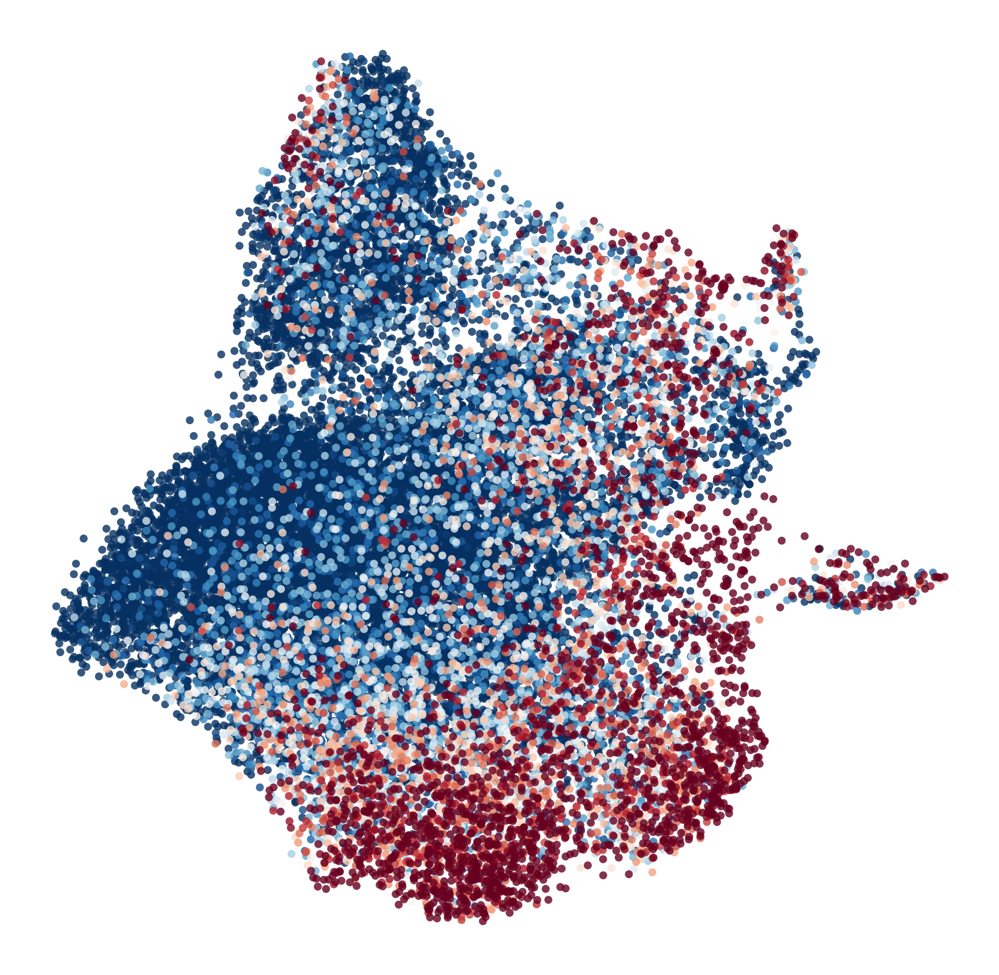

In [61]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes].X.toarray()
except KeyError:
    mes = [g for g in mes if g in adata.var_names]
    data = adata[:, mes].X.toarray()
    
gene_number = len(stemness)
mes_expression = np.sum(data, axis=1)
mes_expression = mes_expression / gene_number
adata.obs['mes_expression'] = mes_expression
adata.obs = adata.obs.assign(mes_expression=pd.Series(mes_expression, index=adata.obs.index))
# set mes_expression as a obs
sc.pl.umap(adata, color='mes_expression', vmin=0, vmax=0.5, size=120, alpha=0.8, title='', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



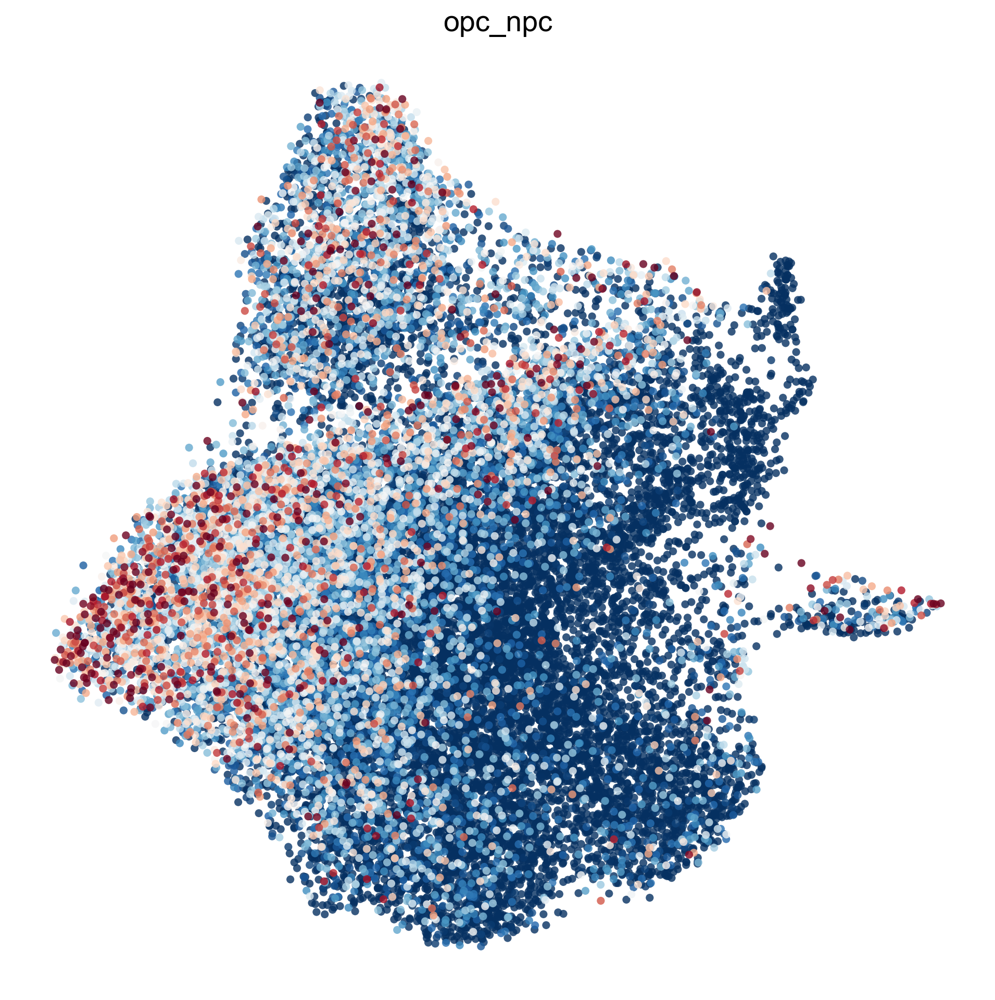

In [36]:
# sc.pl.umap(adata, color=opc_npc_like, size=70)
# add up the expression of opc_npc_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, opc_npc].X.toarray()
except KeyError:
    opc_npc = [g for g in opc_npc if g in adata.var_names]
    data = adata[:, opc_npc].X.toarray()
    
gene_number = len(opc_npc)
opc_npc_expression = np.sum(data, axis=1)
opc_npc_expression = opc_npc_expression / gene_number
adata.obs['opc_npc_expression'] = opc_npc_expression
adata.obs = adata.obs.assign(opc_npc_expression=pd.Series(opc_npc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='opc_npc_expression', vmin=0, vmax=0.3, size=120, alpha=0.8, title='opc_npc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



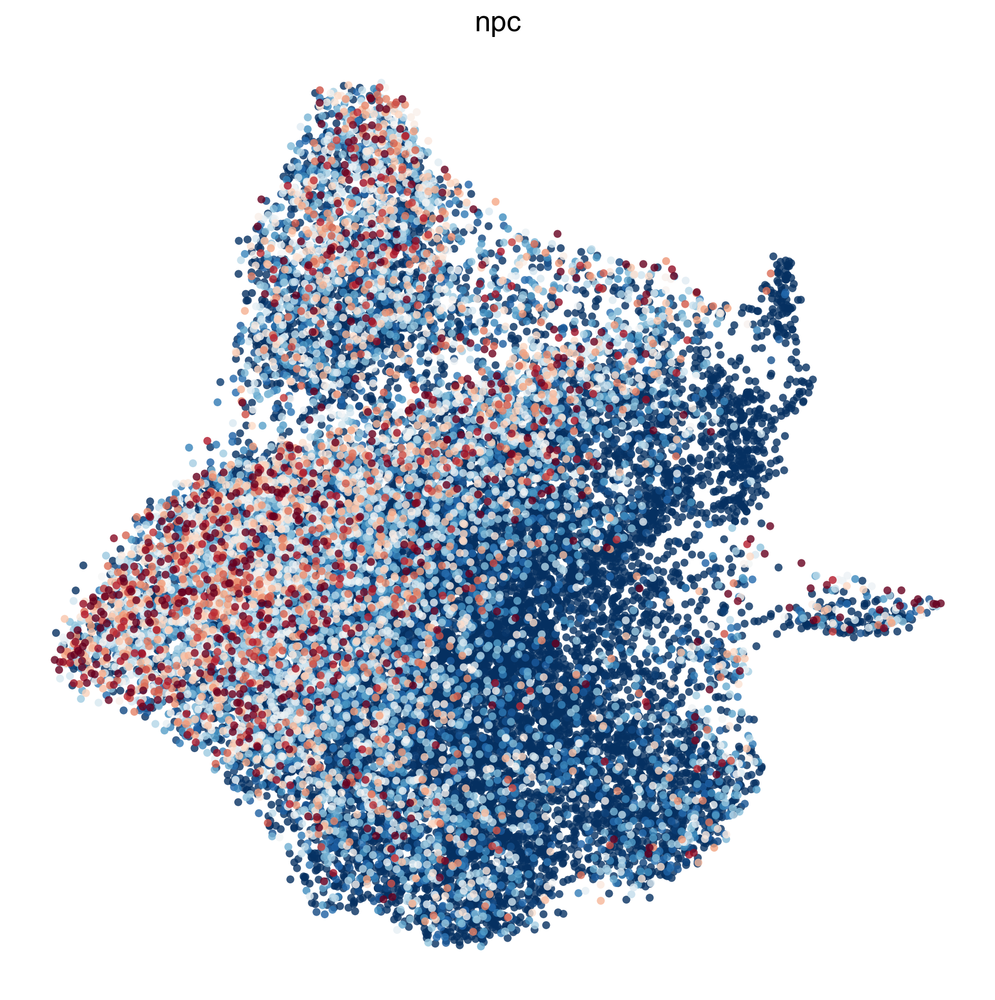

In [35]:
# sc.pl.umap(adata, color=npc_like, size=70)
# add up the expression of npc_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc].X.toarray()
except KeyError:
    npc = [g for g in npc if g in adata.var_names]
    data = adata[:, npc].X.toarray()
    
gene_number = len(npc)
npc_expression = np.sum(data, axis=1) / gene_number
adata.obs['npc_expression'] = npc_expression
adata.obs = adata.obs.assign(npc_expression=pd.Series(npc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc_expression', vmin=0, vmax=0.3, size=120, alpha=0.8, title='npc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



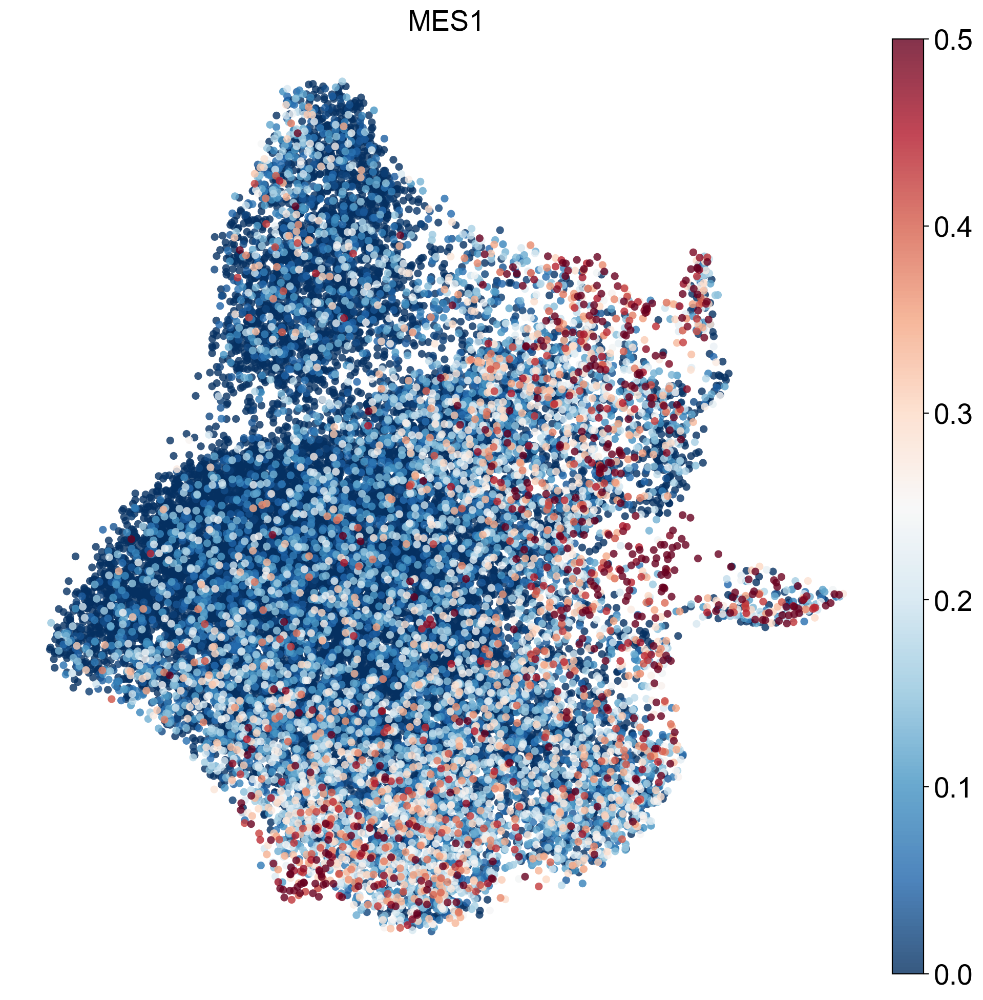

In [34]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes1].X.toarray()
except KeyError:
    mes1 = [g for g in mes1 if g in adata.var_names]
    data = adata[:, mes1].X.toarray()

gene_number = len(mes1)
mes1_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(mes1_expression=pd.Series(mes1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes1_expression', vmin=0, vmax=0.5, size=120, alpha=0.8, title='MES1', cmap='RdBu_r' ,frameon=False, legend_loc=None)



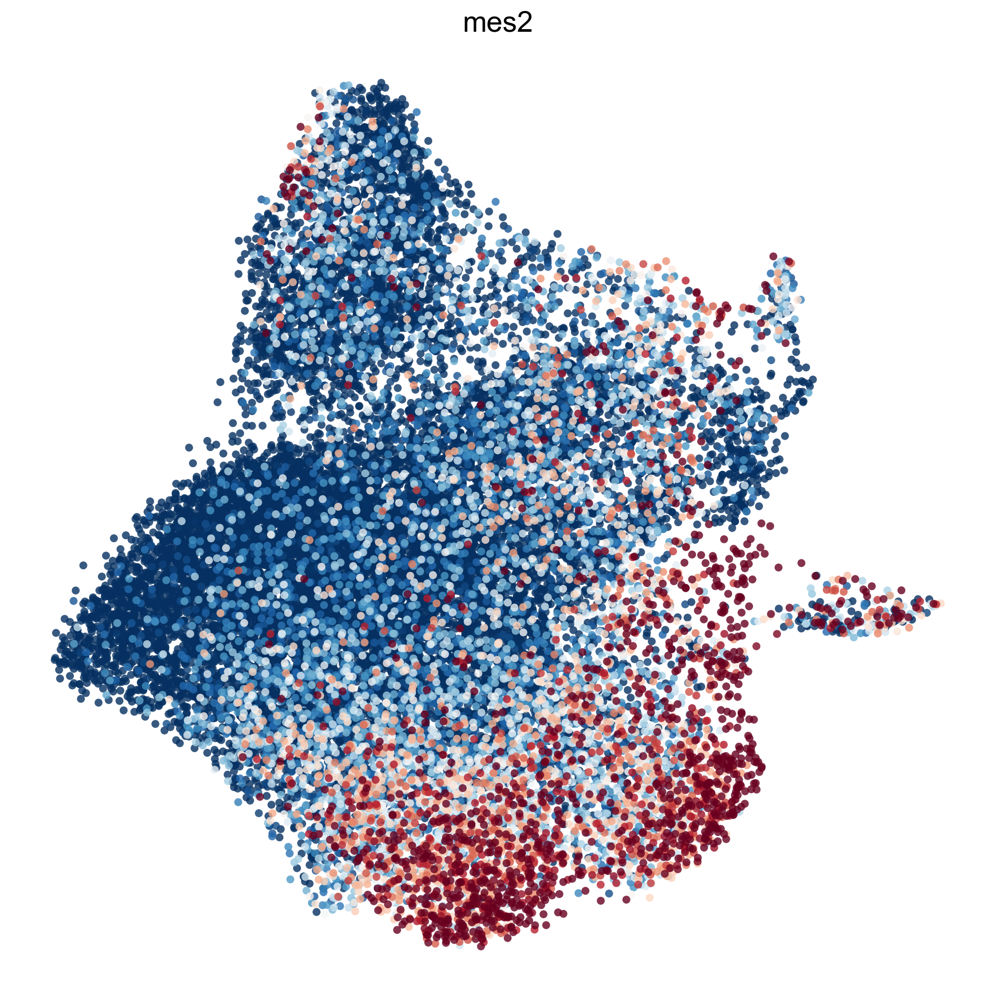

In [39]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes2].X.toarray()
except KeyError:
    mes2 = [g for g in mes2 if g in adata.var_names]
    data = adata[:, mes2].X.toarray()

gene_number = len(mes2)
mes2_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(mes2_expression=pd.Series(mes2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes2_expression', vmin=0, vmax=0.5, size=120, alpha=0.8, title='mes2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



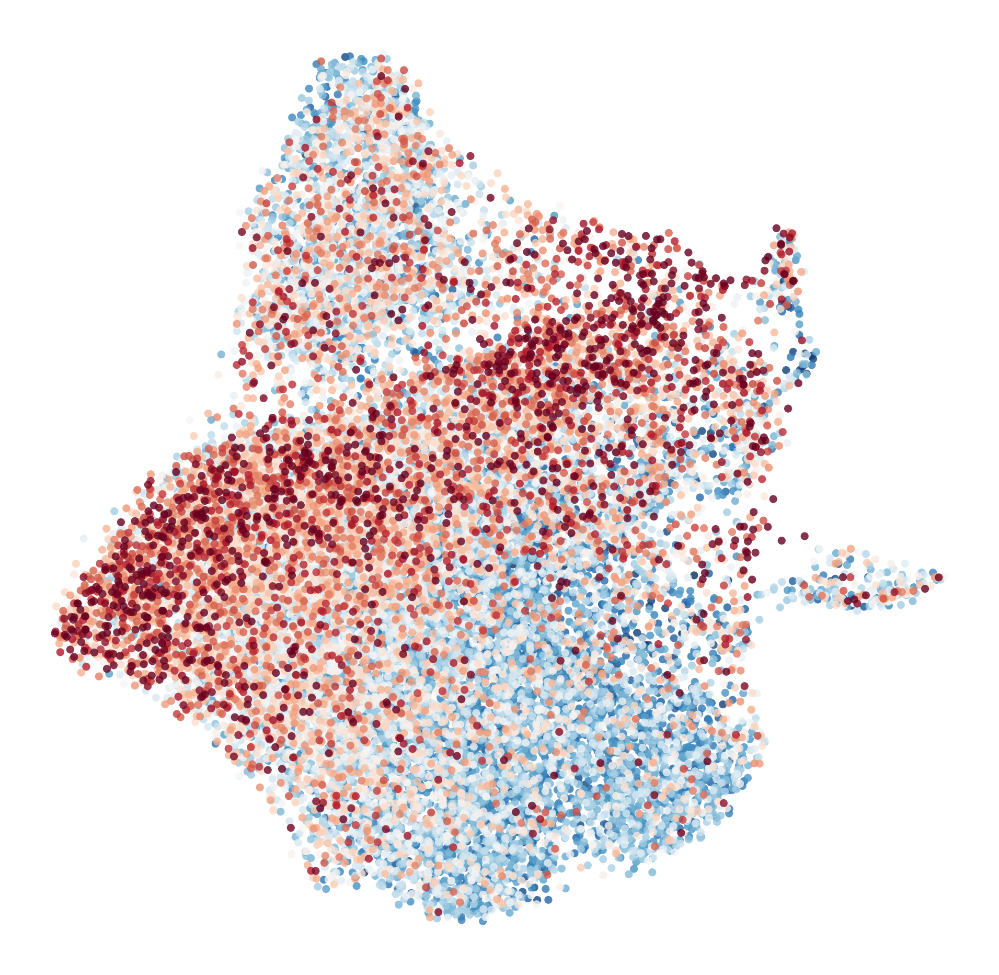

In [54]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, ac].X.toarray()
except KeyError:
    ac = [g for g in ac if g in adata.var_names]
    data = adata[:, ac].X.toarray()
    
gene_number = len(ac)
ac_expression = np.sum(data, axis=1) / gene_number
adata.obs['ac_expression'] = ac_expression
adata.obs = adata.obs.assign(ac_expression=pd.Series(ac_expression, index=adata.obs.index))
sc.pl.umap(adata, color='ac_expression',vmax=0.4, size=120, alpha=0.8, title='', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



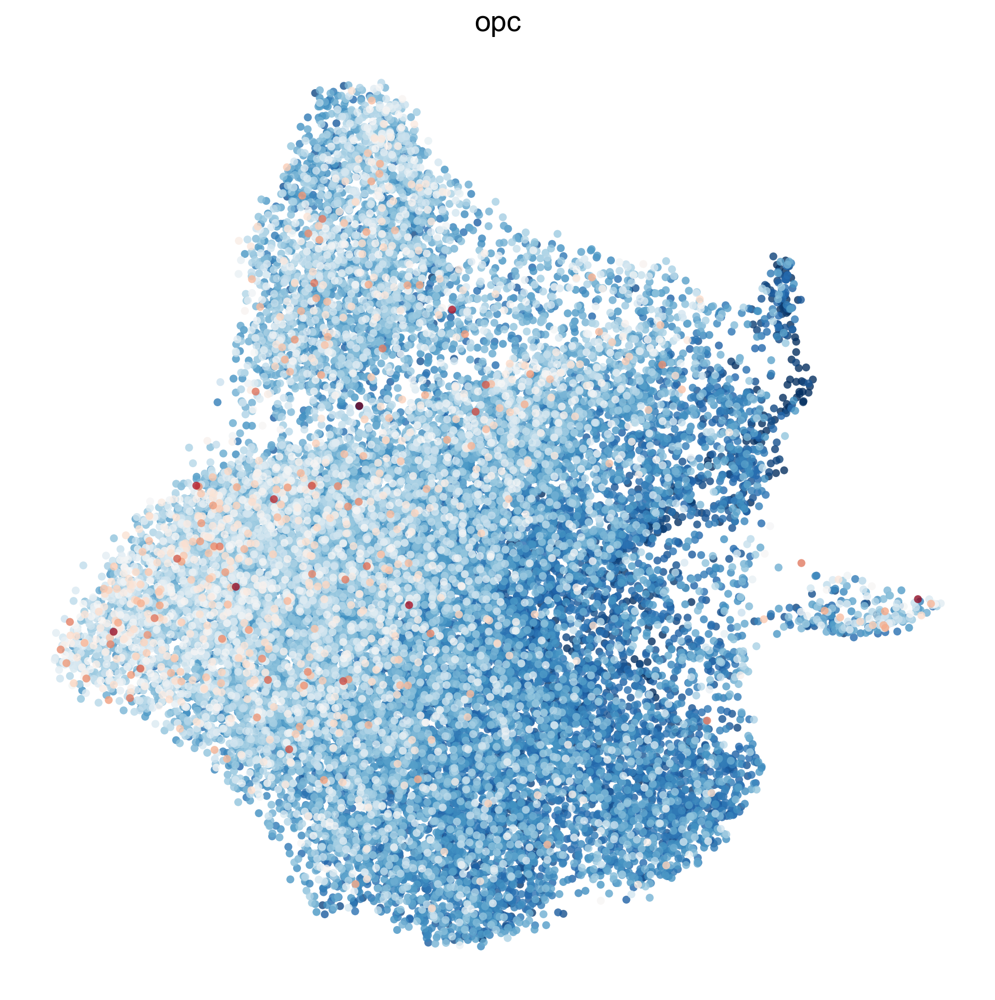

In [43]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, opc].X.toarray()
except KeyError:
    opc = [g for g in opc if g in adata.var_names]
    data = adata[:, opc].X.toarray()

gene_number = len(opc)
opc_expression = np.sum(data, axis=1) / gene_number
adata.obs['opc_expression'] = opc_expression
adata.obs = adata.obs.assign(opc_expression=pd.Series(opc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='opc_expression', size=120, alpha=0.8, title='opc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



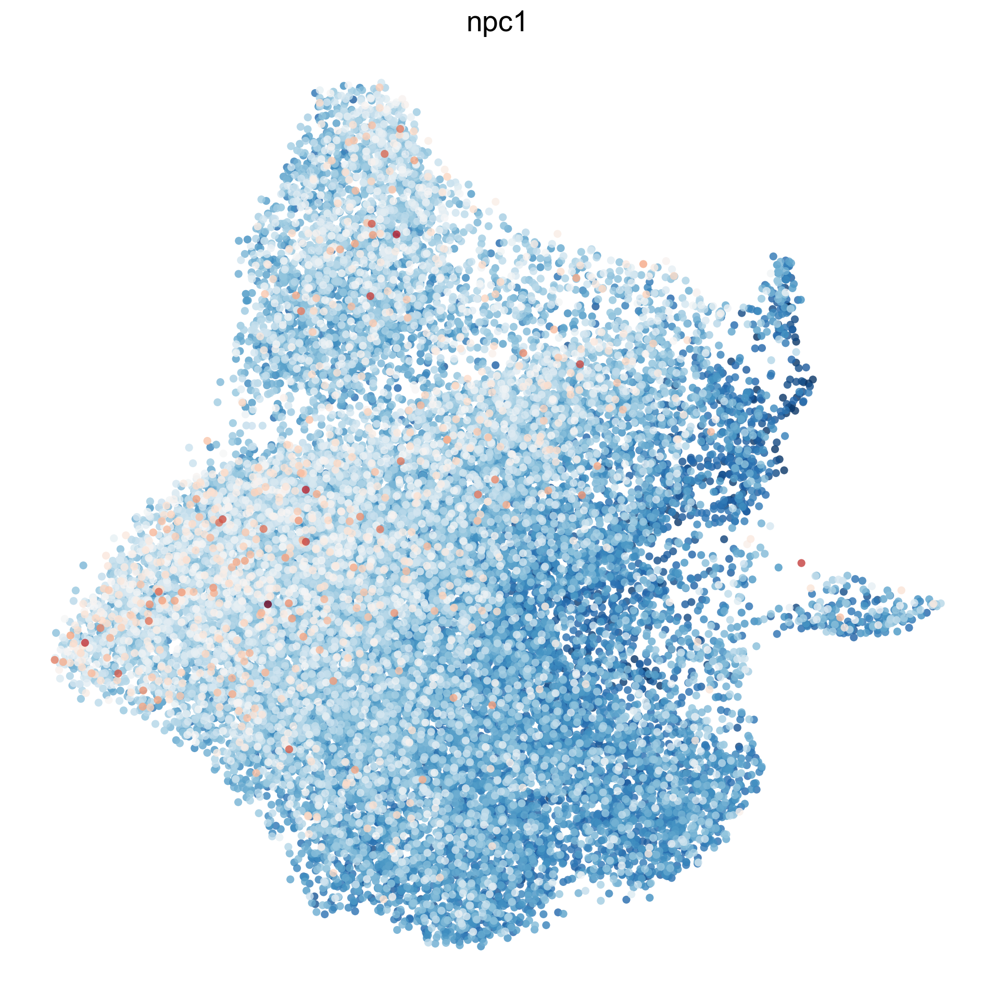

In [44]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc1].X.toarray()
except KeyError:
    npc1 = [g for g in npc1 if g in adata.var_names]
    data = adata[:, npc1].X.toarray()
    
gene_number = len(npc1)
npc1_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(npc1_expression=pd.Series(npc1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc1_expression', size=120, alpha=0.8, title='npc1', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



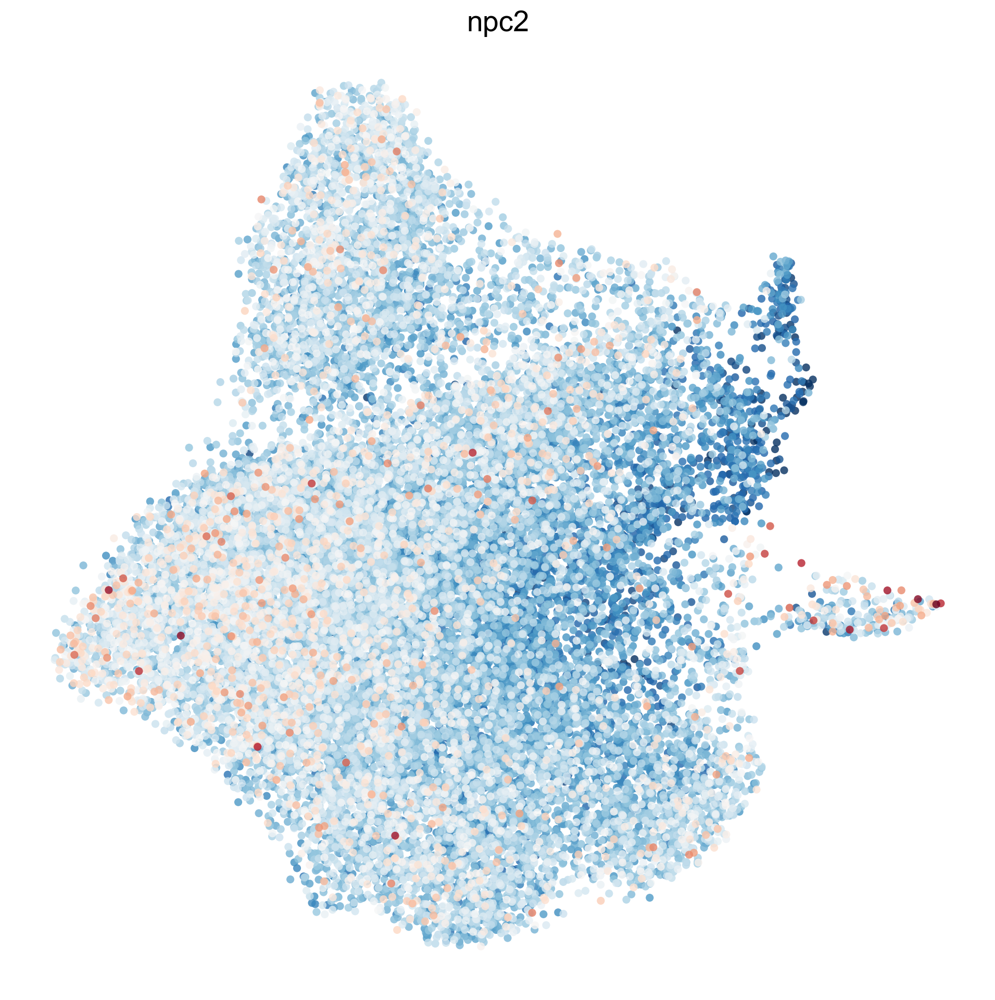

In [45]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc2].X.toarray()
except KeyError:
    npc2 = [g for g in npc2 if g in adata.var_names]
    data = adata[:, npc2].X.toarray()
    
gene_number = len(npc2)
npc2_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(npc2_expression=pd.Series(npc2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc2_expression', size=120, alpha=0.8, title='npc2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



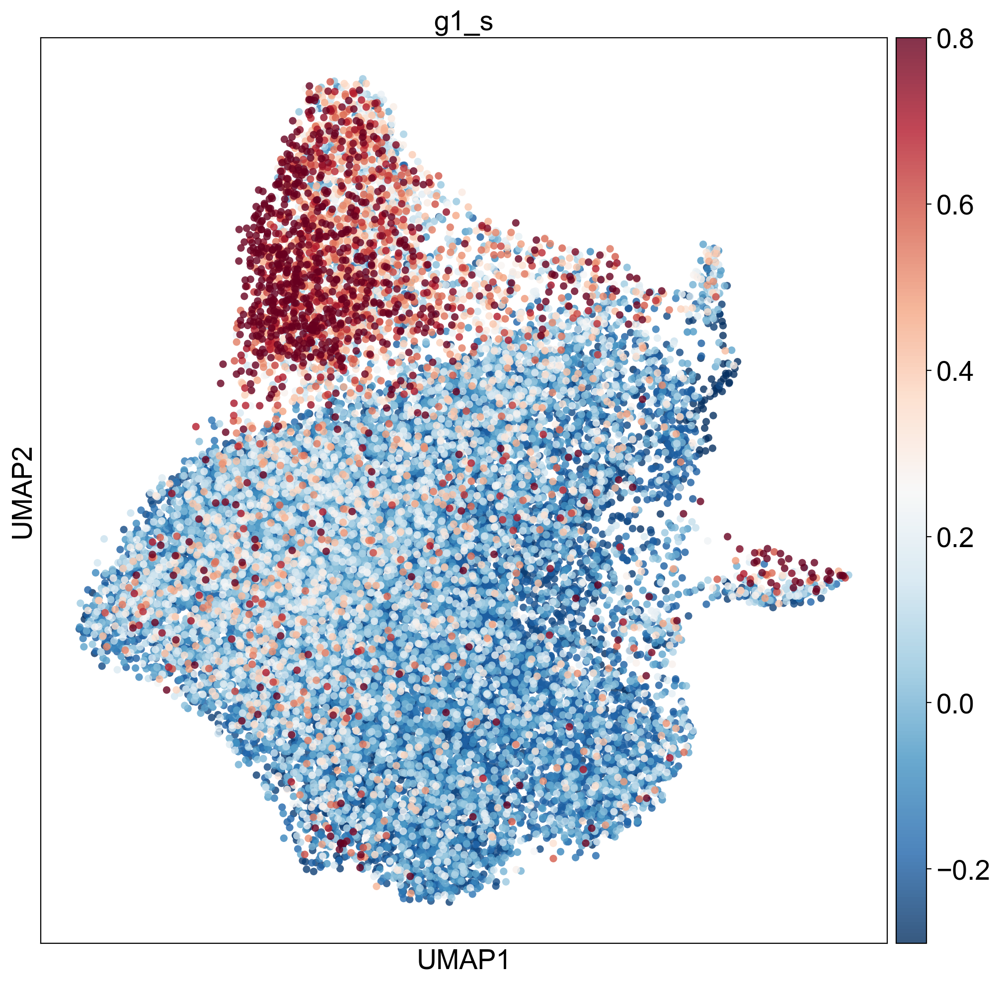

In [47]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g1_s].X.toarray()
except KeyError:
    g1_s = [g for g in g1_s if g in adata.var_names]
    data = adata[:, g1_s].X.toarray()
    
gene_number = len(g1_s)
g1_s_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(g1_s_expression=pd.Series(g1_s_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g1_s_expression', vmax=15, size=120, alpha=0.8, title='g1_s', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g1_s_expression', vmax=0.8, size=120, alpha=0.8, title='g1_s' , cmap='RdBu_r')




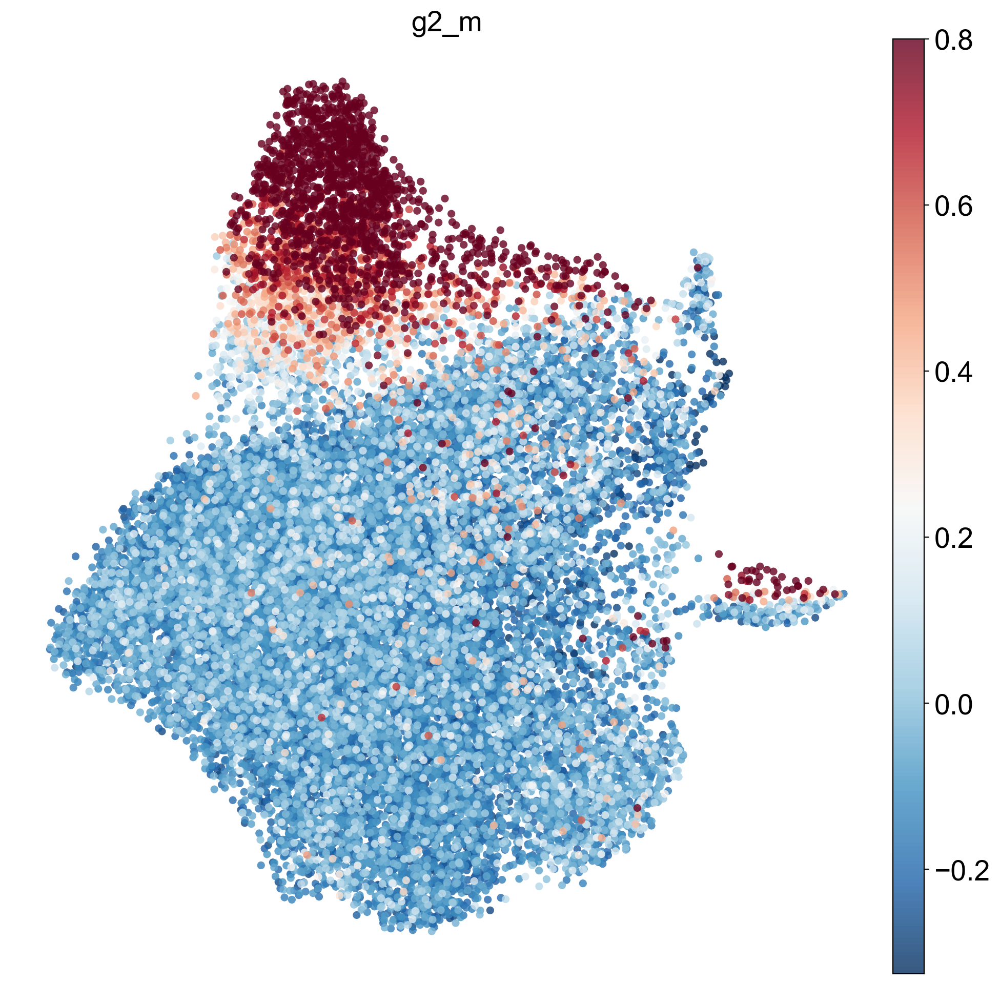

In [48]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g2_m].X.toarray()
except KeyError:
    g2_m = [g for g in g2_m if g in adata.var_names]
    data = adata[:, g2_m].X.toarray()
    
gene_number = len(g2_m)
g2_m_expression = np.sum(data, axis=1) / gene_number
adata.obs['g2_m_expression'] = g2_m_expression
adata.obs = adata.obs.assign(g2_m_expression=pd.Series(g2_m_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g2_m_expression', vmax=20, size=120, alpha=0.8, title='g2_m', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g2_m_expression', vmax=0.8, size=120, alpha=0.8, title='g2_m' ,frameon=False, legend_loc=None, cmap='RdBu_r')



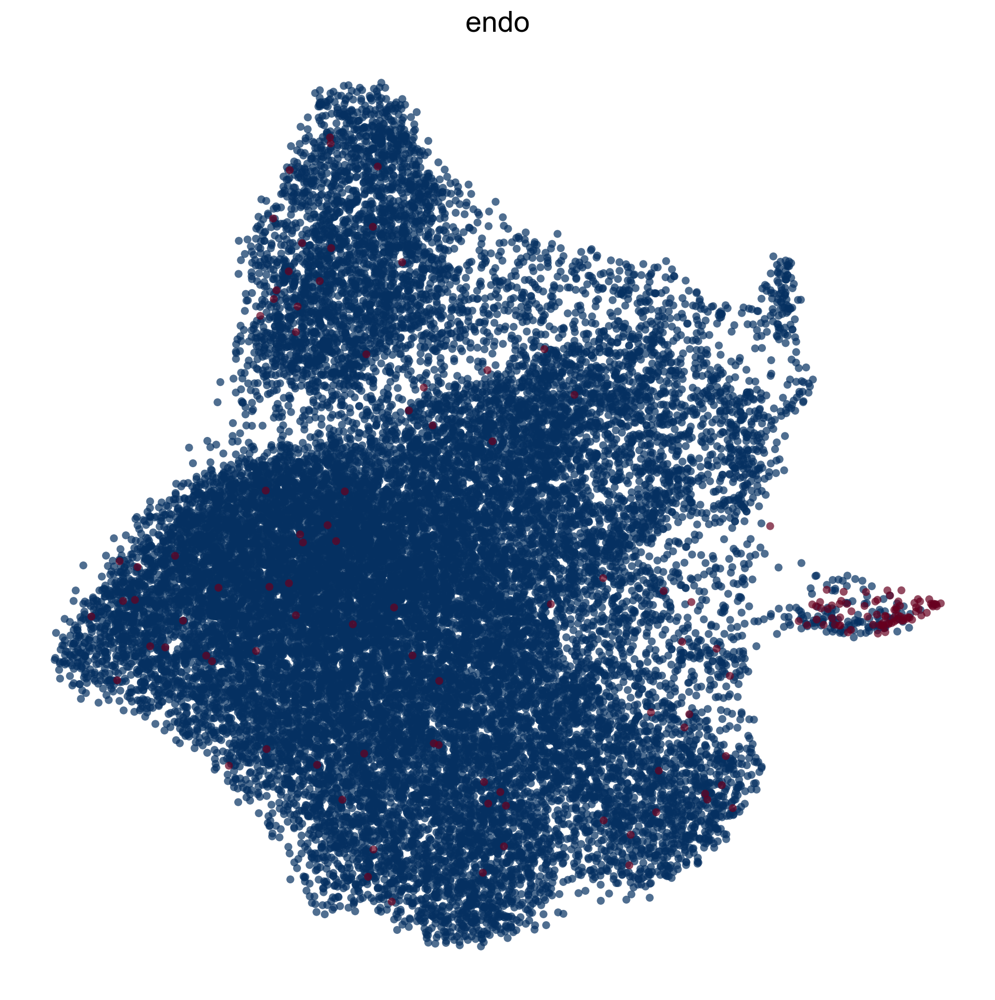

In [50]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, endo].X.toarray()
except KeyError:
    endo = [g for g in endo if g in adata.var_names]
    data = adata[:, endo].X.toarray()
    
gene_number = len(endo)
endo_expression = np.sum(data, axis=1) / gene_number
adata.obs['endo_expression'] = endo_expression
adata.obs = adata.obs.assign(endo_expression=pd.Series(endo_expression, index=adata.obs.index))
sc.pl.umap(adata, color='endo_expression', vmax=0.6, vmin=0, size=120, alpha=0.7, title='endo' ,frameon=False, legend_loc=None, colorbar_loc=None, cmap='RdBu_r')




In [51]:
# drop cell_type_f
# adata.obs = adata.obs.drop(columns=['cell_type_f'])
# # Annotating types
adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '7', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '10', 'cell_type_f'] = 'Mesenchymal'

adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'Astrocyte'

# adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] ='Cancer Stem Cell' 

adata.obs.loc[adata.obs.louvain == '0', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
# adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'

adata.obs.loc[adata.obs.louvain == '3', 'cell_type_f'] = 'Cycling Cells'

adata.obs.loc[adata.obs.louvain == '9', 'cell_type_f'] = 'Endothelial'



In [62]:
# drop cell_type_f
adata.obs = adata.obs.drop(columns=['cell_type_f'])
# # Annotating types
adata.obs.loc[adata.obs.leiden == '0', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.leiden == '7', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.leiden == '9', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.leiden == '10', 'cell_type_f'] = 'Mesenchymal'

adata.obs.loc[adata.obs.leiden == '8', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.leiden == '4', 'cell_type_f'] = 'Astrocyte'

# adata.obs.loc[adata.obs.leiden == '5', 'cell_type_f'] ='Cancer Stem Cell' 

adata.obs.loc[adata.obs.leiden == '3', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.leiden == '5', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.leiden == '2', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'

adata.obs.loc[adata.obs.leiden == '3', 'cell_type_f'] = 'Cycling Cells'

adata.obs.loc[adata.obs.leiden == '12', 'cell_type_f'] = 'Endothelial'



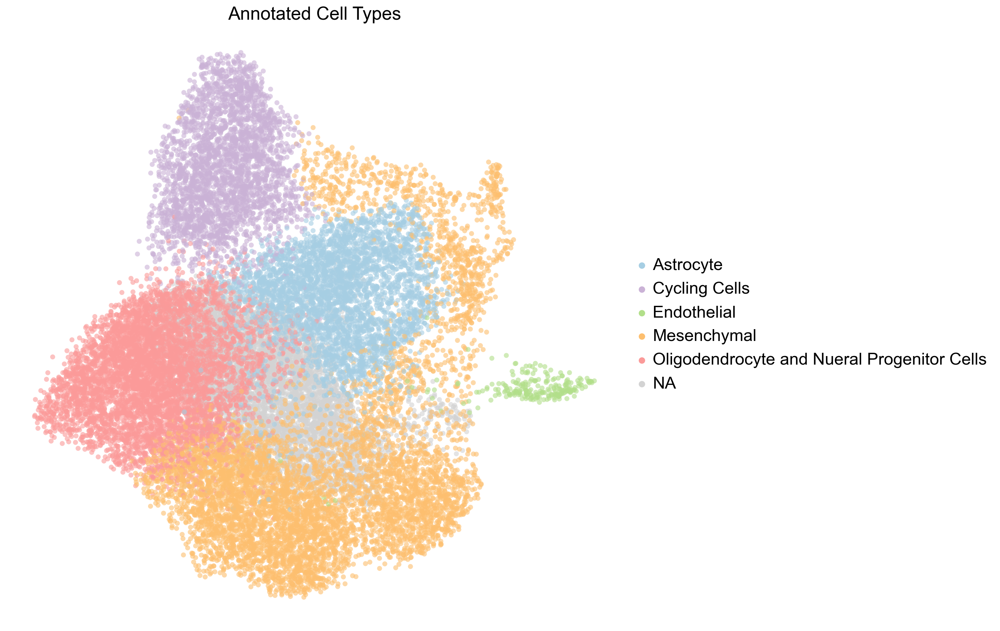

In [63]:
# add opacity
# choose colorblind friendly colors
# choose order of colors from Paired
palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors
palette = [palette[0], palette[8], palette[2], palette[6], palette[4]]
# make the last a light gray
palette.append('#D3D3D3')

sc.pl.umap(adata, color="cell_type_f", title="Annotated Cell Types", size=120, alpha=0.6, palette=palette, frameon=False, colorbar_loc=None)
# set font size
plt.rcParams.update({'font.size': 50})

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


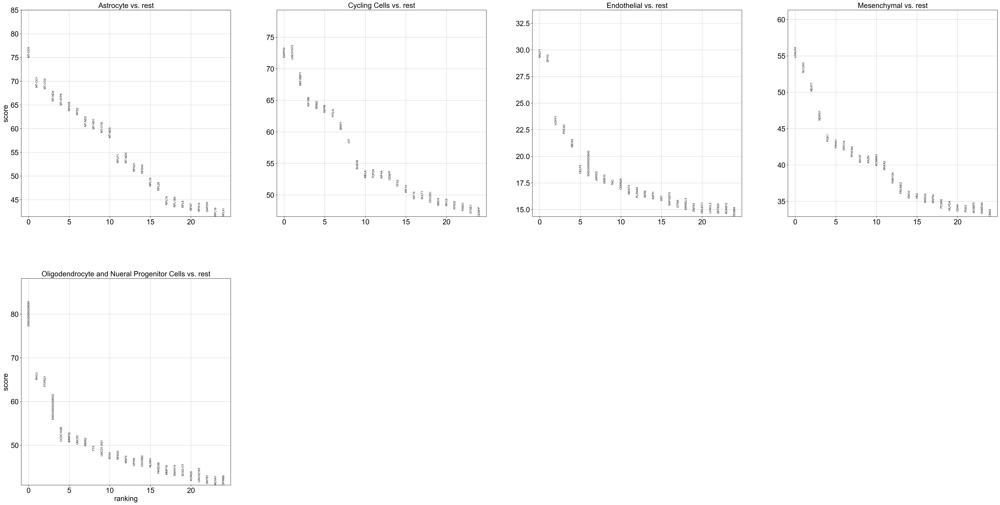

dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])


In [69]:
rank_gene_groups([adata], category='cell_type_f', number_of_genes=25, method="t-test")

In [ ]:
def rank_gene_groups(running_on, category='leiden', number_of_genes = 25, method = "t-test"):    


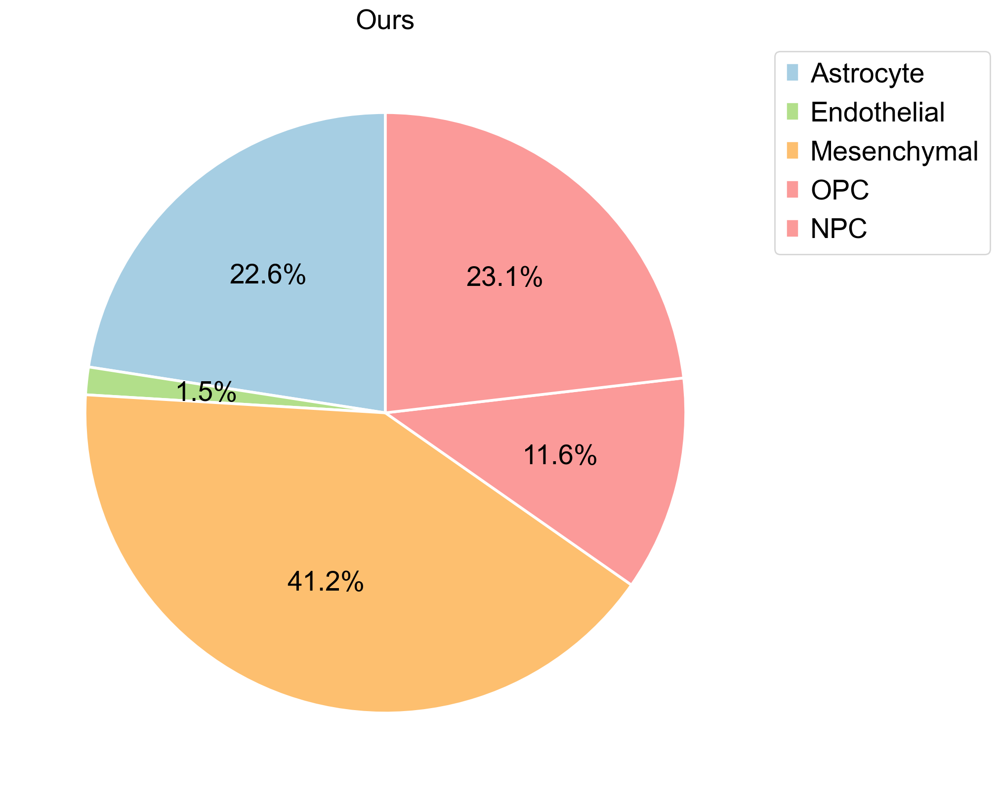

In [67]:

# use the following order and colors:

# make a dataframe of the cell types
cell_type_df = pd.DataFrame(adata.obs['cell_type_f'].value_counts())
# split progenitor values into two, 2/3 are NPC and 1/3 are OPC
cell_type_df.loc['OPC'] = cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df.loc['NPC'] = 2*cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df = cell_type_df.drop(['Oligodendrocyte and Nueral Progenitor Cells'])
# # rename the progenitor values
cell_type_df = cell_type_df.rename(index={'OPC': 'OPC', 'NPC': 'NPC'})

# # reorder to Endothelial, Mesenchymal, OPC-like, Astrocyte-like, Proneural-like
cell_type_df = cell_type_df.reindex(['Endothelial', 'Mesenchymal','Astrocyte', 'OPC', 'NPC'])
cell_type_df = cell_type_df.reindex(['Astrocyte', 'Endothelial','Mesenchymal', 'OPC', 'NPC'])

palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors
palette = [palette[0], palette[2], palette[6], palette[4], palette[4]]


cell_type_df
# make a pie chart of the cell types, remove the labels from the chart itself, outline black, percentage to 1 decimal place and farther out
cell_type_df.plot.pie(y='count', figsize=(20, 10), colors=palette, autopct='%1.1f%%', startangle=90, legend=True, fontsize=20, title='Ours', ylabel='', labeldistance=None, wedgeprops=dict(linewidth=2, edgecolor='white'), textprops={'fontsize': 20})
# make legend outside of pie chart
plt.legend(bbox_to_anchor=(1,1), loc="upper left", prop={'size': 20})
# save figure   
# plt.savefig('figures/pie_chart_our_classifications.png', bbox_inches='tight', dpi=300)

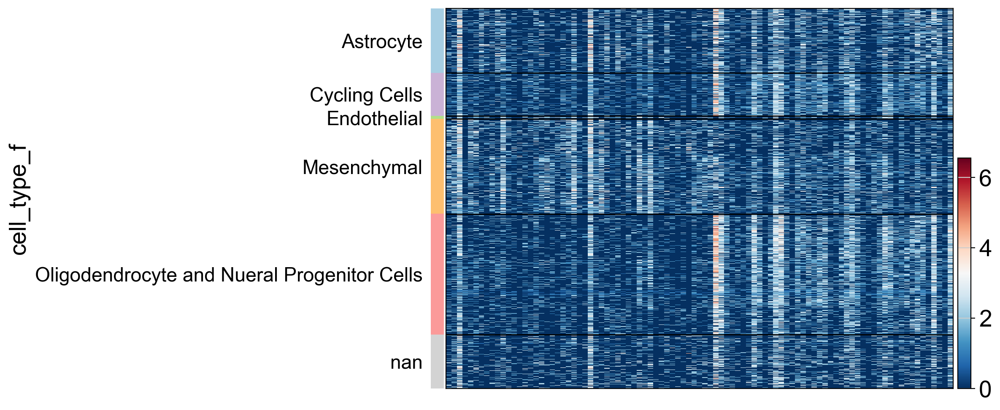

In [114]:
import concurrent.futures

adata_sample = adata.copy()
subset_genes =  mes + opc + npc + ac + endo
nan_genes = ['ASCL1', 'C8orf4', 'ERO1L', 'FIBIN', 'GPR56', 'HMP19', 'HN1', 'HRASLS', 'LOC150568', 'LPPR1', 'MT1E', 'PPAP2B', 'SEPT3', 'SERPINA3', 'TMEM161B-AS1', 'TMEM206', 'WARS']
subset_genes = [g for g in subset_genes if g not in nan_genes]

# Define a function that will be run in parallel
def process_gene(gene):
    data = adata_sample[:, gene]
    if data.var.loc[gene, 'mean_counts'] < 0.2:
        return gene
    return None

# Create a ThreadPoolExecutor
with concurrent.futures.ThreadPoolExecutor() as executor:
    # Use the executor to process the genes in parallel
    try:
        genes_to_remove = list(executor.map(process_gene, subset_genes))
    except Exception as e:
        pass

# Filter out None values from the results
genes_to_remove = [gene for gene in genes_to_remove if gene is not None]

# Remove the genes from subset_genes
subset_genes = [g for g in subset_genes if g not in genes_to_remove]

sc.pl.heatmap(adata_sample, var_names=subset_genes, groupby='cell_type_f', cmap='RdBu_r')

In [115]:
# Sorting by Dispersion Norm

temp = adata_sample.copy()
# reduce to subset genes
temp = temp[:, subset_genes]
# remove duplicates
temp = temp[:, ~temp.var.index.duplicated()]
temp = temp.var['dispersions_norm'].sort_values(ascending=False).index
temp
genes = temp.to_numpy()
genes


array(['SERPINE1', 'IGFBP3', 'FTL', 'S100A10', 'LGALS1', 'RPL21', 'CLU',
       'SPARC', 'NDRG1', 'CDKN1A', 'TIMP1', 'SLC2A3', 'HILPDA', 'HSPA5',
       'FN1', 'GDF15', 'AKAP12', 'LDHA', 'CD44', 'SOD2', 'GBE1', 'ANXA2',
       'INSIG2', 'SLC6A6', 'LGALS3', 'SOX4', 'ENO2', 'TUBA1C', 'SLC1A3',
       'BNIP3L', 'TTYH1', 'PRDX6', 'SPARCL1', 'TUBA1A', 'BTG2', 'SNAP25',
       'NAMPT', 'LIMA1', 'P4HA1', 'SOX2-OT', 'VIM', 'FNBP1L', 'PGK1',
       'SQSTM1', 'GLCCI1', 'PFKP', 'HSPA9', 'NREP', 'MAP2', 'PTPRZ1',
       'HIP1', 'ATP1B1', 'WWTR1', 'ACTN1', 'DPYSL5', 'CLIC4', 'UFM1',
       'SLC39A14', 'ETV1', 'GPM6B', 'TRAM1', 'NFIB', 'PON2', 'SCD5',
       'DPYSL3', 'KIF5C', 'TCF4', 'MAP1B', 'SERINC5', 'VCAN', 'C1S',
       'PTPRS', 'EPB41L2', 'RNF13', 'XPOT', 'CHD7', 'CEP170', 'RBFOX2',
       'TCF12'], dtype=object)

/var/folders/td/y1xv90r510924xxsnlfkjgrc0000gn/T/ipykernel_836/638923289.py:17: RuntimeWarning: invalid value encountered in log1p
  adata_sample.X = np.log1p(adata_sample.X)


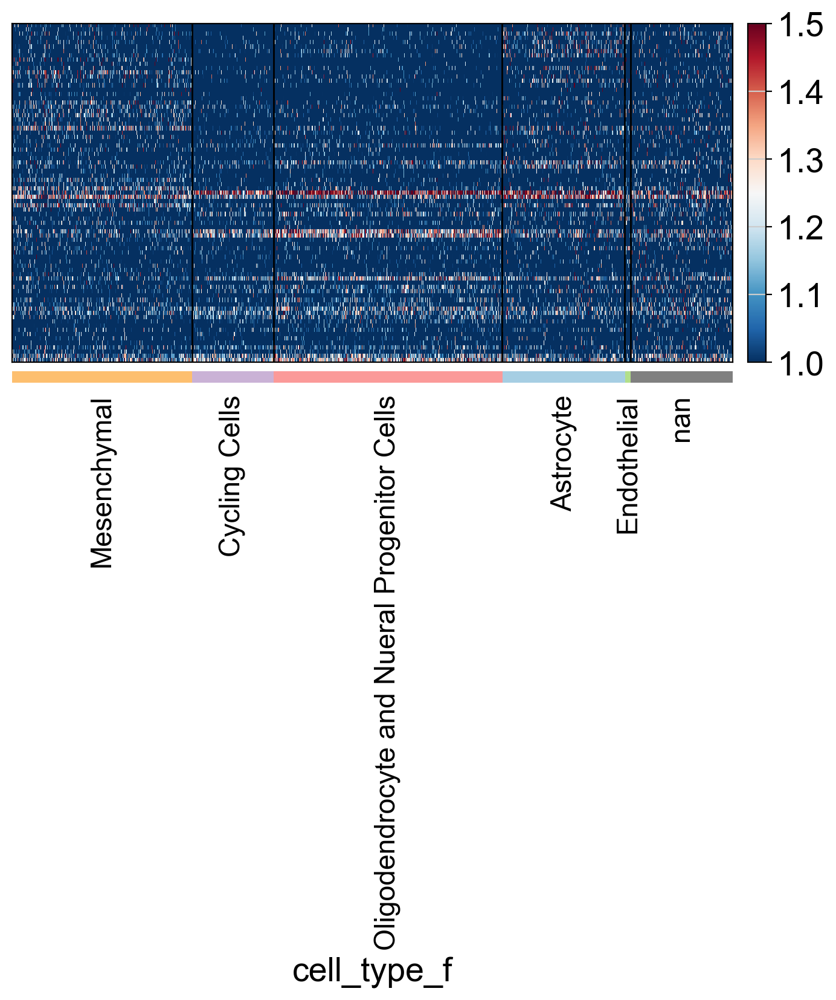

In [135]:
# bin and blur alittle bit the genes a little bit
# remove 
# normalize the data

# remove repeats for subs
# reprder palette to be mes opc npc ac endo
palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors


order = ['Mesenchymal', 'Cycling Cells', 'Oligodendrocyte and Nueral Progenitor Cells', 'Astrocyte', 'Endothelial', 'nan']
adata_sample.obs['cell_type_f'] = adata_sample.obs['cell_type_f'].cat.reorder_categories(order)
adata_sample.uns['cell_type_f_colors'] = [palette[6], palette[8],palette[4], palette[0], palette[2], 'gray']
adata_sample.raw = adata_sample
adata_sample.X = np.log1p(adata_sample.X)

sc.pl.heatmap(adata_sample, var_names=genes, groupby='cell_type_f', cmap='RdBu_r',swap_axes=True,figsize=(8, 4),  vmin=1, vmax=1.5, show_gene_labels=False, log=True)
